# Satellite data from April 2021

Analyzing the Drone Ocean Color Data in relation to MODIS Chla and SST 

In [1]:
import numpy as np
import xarray as xr
import os.path as op
from matplotlib import colors, ticker
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import datetime
%matplotlib inline

import cartopy.crs as crs
# import hvplot.xarray
import pandas as pd
import geopandas as gpd
# import hvplot.pandas

import netCDF4
from netCDF4 import Dataset

### Load in flight data

In [211]:
gdf1

,chla,Latitude,Longitude,sst,time_str,geometry,sst_c,time,flight
0,0.122446,34.039461,-76.276736,289.23,2021-04-27 13:10:57,POINT (-76.27674 34.03946),16.08,2021-04-27 13:10:57,1
1,0.121662,34.039461,-76.276739,289.36,2021-04-27 13:10:59,POINT (-76.27674 34.03946),16.21,2021-04-27 13:10:59,1
2,0.121413,34.039461,-76.276739,289.47,2021-04-27 13:11:01,POINT (-76.27674 34.03946),16.32,2021-04-27 13:11:01,1
3,0.121824,34.039461,-76.276739,289.31,2021-04-27 13:11:03,POINT (-76.27674 34.03946),16.16,2021-04-27 13:11:03,1
4,0.120904,34.039461,-76.276733,289.74,2021-04-27 13:11:12,POINT (-76.27673 34.03946),16.59,2021-04-27 13:11:12,1
...,...,...,...,...,...,...,...,...,...
254,0.100506,34.034953,-76.262631,292.25,2021-04-27 13:22:42,POINT (-76.26263 34.03495),19.10,2021-04-27 13:22:42,1
255,0.100830,34.034883,-76.262503,291.68,2021-04-27 13:22:45,POINT (-76.26250 34.03488),18.53,2021-04-27 13:22:45,1
256,0.099254,34.034822,-76.262392,291.47,2021-04-27 13:22:47,POINT (-76.26239 34.03482),18.32,2021-04-27 13:22:47,1
257,0.101585,34.034767,-76.262289,291.43,2021-04-27 13:22:48,POINT (-76.26229 34.03477),18.28,2021-04-27 13:22:48,1


In [2]:
# flight 1
gdf1 = gpd.read_file('chla_sst_flight1.shp')
gdf1['sst_c'] = gdf1['sst']-273.15
gdf1['time'] = pd.to_datetime(gdf1['time_str'])
gdf1['flight'] = 1
# for some reason I can't have the geometry column due to a bug in holoviz
df1 = gdf1.drop('geometry', axis=1)

# flight 2
gdf2 = gpd.read_file('chla_sst_flight2.shp')
gdf2['time'] = pd.to_datetime(gdf2['time_str'])
gdf2['sst_c'] = gdf2['sst']-273.15
gdf2['flight'] = 2
df2 = gdf2.drop('geometry', axis=1)


# flight 3
gdf3 = gpd.read_file('chla_sst_flight3_flight1_blocked.shp')
gdf3['sst_c'] = gdf3['sst']-273.15
gdf3['time'] = pd.to_datetime(gdf3['time_str'])
gdf3['flight'] = 3
df3 = gdf3.drop('geometry', axis=1)

# flight 3
gdf4 = gpd.read_file('chla_sst_flight4.shp')
gdf4['sst_c'] = gdf4['sst']-273.15
gdf4['time'] = pd.to_datetime(gdf4['time_str'])
gdf4['flight'] = 4
df4 = gdf4.drop('geometry', axis=1)

In [3]:
gdf1

,chla,Latitude,Longitude,sst,time_str,geometry,sst_c,time,flight
0,0.122446,34.039461,-76.276736,289.23,2021-04-27 13:10:57,POINT (-76.27674 34.03946),16.08,2021-04-27 13:10:57,1
1,0.121662,34.039461,-76.276739,289.36,2021-04-27 13:10:59,POINT (-76.27674 34.03946),16.21,2021-04-27 13:10:59,1
2,0.121413,34.039461,-76.276739,289.47,2021-04-27 13:11:01,POINT (-76.27674 34.03946),16.32,2021-04-27 13:11:01,1
3,0.121824,34.039461,-76.276739,289.31,2021-04-27 13:11:03,POINT (-76.27674 34.03946),16.16,2021-04-27 13:11:03,1
4,0.120904,34.039461,-76.276733,289.74,2021-04-27 13:11:12,POINT (-76.27673 34.03946),16.59,2021-04-27 13:11:12,1
...,...,...,...,...,...,...,...,...,...
254,0.100506,34.034953,-76.262631,292.25,2021-04-27 13:22:42,POINT (-76.26263 34.03495),19.10,2021-04-27 13:22:42,1
255,0.100830,34.034883,-76.262503,291.68,2021-04-27 13:22:45,POINT (-76.26250 34.03488),18.53,2021-04-27 13:22:45,1
256,0.099254,34.034822,-76.262392,291.47,2021-04-27 13:22:47,POINT (-76.26239 34.03482),18.32,2021-04-27 13:22:47,1
257,0.101585,34.034767,-76.262289,291.43,2021-04-27 13:22:48,POINT (-76.26229 34.03477),18.28,2021-04-27 13:22:48,1


In [5]:
gdf2

,chla,Latitude,Longitude,sst,time_str,geometry,time,sst_c,flight
0,0.089634,34.020764,-76.184039,294.66,2021-04-27 14:44:25,POINT (-76.18404 34.02076),2021-04-27 14:44:25,21.51,2
1,0.100023,34.020764,-76.184039,294.62,2021-04-27 14:44:27,POINT (-76.18404 34.02076),2021-04-27 14:44:27,21.47,2
2,0.085685,34.020764,-76.184039,294.60,2021-04-27 14:44:29,POINT (-76.18404 34.02076),2021-04-27 14:44:29,21.45,2
3,0.079555,34.020711,-76.184006,294.71,2021-04-27 14:44:31,POINT (-76.18401 34.02071),2021-04-27 14:44:31,21.56,2
4,0.094565,34.020647,-76.183964,294.82,2021-04-27 14:44:33,POINT (-76.18396 34.02065),2021-04-27 14:44:33,21.67,2
...,...,...,...,...,...,...,...,...,...
323,0.080117,34.024150,-76.187331,292.65,2021-04-27 14:59:14,POINT (-76.18733 34.02415),2021-04-27 14:59:14,19.50,2
324,0.081967,34.024292,-76.187194,292.54,2021-04-27 14:59:16,POINT (-76.18719 34.02429),2021-04-27 14:59:16,19.39,2
325,0.078997,34.024453,-76.187053,292.38,2021-04-27 14:59:18,POINT (-76.18705 34.02445),2021-04-27 14:59:18,19.23,2
326,0.092468,34.024614,-76.186908,292.40,2021-04-27 14:59:20,POINT (-76.18691 34.02461),2021-04-27 14:59:20,19.25,2


In [6]:
gdf3

,chla,Latitude,Longitude,sst,time_str,geometry,sst_c,time,flight
0,0.145799,34.036681,-76.158056,295.15,2021-04-27 15:41:21,POINT (-76.15806 34.03668),22.00,2021-04-27 15:41:21,3
1,0.149091,34.036678,-76.158058,295.32,2021-04-27 15:41:31,POINT (-76.15806 34.03668),22.17,2021-04-27 15:41:31,3
2,0.148728,34.036678,-76.158056,295.04,2021-04-27 15:41:32,POINT (-76.15806 34.03668),21.89,2021-04-27 15:41:32,3
3,0.146130,34.036678,-76.157981,294.71,2021-04-27 15:41:34,POINT (-76.15798 34.03668),21.56,2021-04-27 15:41:34,3
4,0.146641,34.036672,-76.157842,294.31,2021-04-27 15:41:37,POINT (-76.15784 34.03667),21.16,2021-04-27 15:41:37,3
...,...,...,...,...,...,...,...,...,...
351,0.136566,34.054464,-76.212683,291.98,2021-04-27 15:57:37,POINT (-76.21268 34.05446),18.83,2021-04-27 15:57:37,3
352,0.137030,34.054511,-76.212689,291.05,2021-04-27 15:57:38,POINT (-76.21269 34.05451),17.90,2021-04-27 15:57:38,3
353,0.132488,34.054533,-76.212689,290.30,2021-04-27 15:57:41,POINT (-76.21269 34.05453),17.15,2021-04-27 15:57:41,3
354,0.133160,34.054528,-76.212689,290.06,2021-04-27 15:57:43,POINT (-76.21269 34.05453),16.91,2021-04-27 15:57:43,3


### Sat Data

MODIS

In [3]:
fn = 'data/A2021117183000.L2_LAC_OC.nc'
#fn = 'data/AQUA_MODIS.20210427T183000.L2.SST.NRT.nc'
dataset = Dataset(fn)
gd=dataset.groups['geophysical_data']
nav=dataset.groups['navigation_data']
lons = nav.variables["longitude"][:]
lats = nav.variables["latitude"][:]

flags= gd.variables["l2_flags"][:]
print(gd.variables.keys())
# # create the chl dataset
chl_ds = xr.Dataset({'chlor_a':(('x', 'y'),gd.variables['chlor_a'][:].data)},
                    coords = {'lat': (('x', 'y'), lats),
                              'lon': (('x', 'y'), lons)},
                    attrs={'variable':'Chlorophyll-a'})
modis_ds = chl_ds.where(chl_ds['chlor_a'] != -32767.0)
modis_ds
# # # create the chl dataset
# sst_ds = xr.Dataset({'sst':(('x', 'y'),gd.variables['sst'][:].data)},
#                     coords = {'lat': (('x', 'y'), lats),
#                               'lon': (('x', 'y'), lons)},
#                     attrs={'variable':'SST'})
# sst_ds = sst_ds.where(sst_ds['sst'] != -32767.0)
# sst_ds

dict_keys(['aot_869', 'angstrom', 'Rrs_412', 'Rrs_443', 'Rrs_469', 'Rrs_488', 'Rrs_531', 'Rrs_547', 'Rrs_555', 'Rrs_645', 'Rrs_667', 'Rrs_678', 'chlor_a', 'chl_ocx', 'Kd_490', 'pic', 'poc', 'ipar', 'nflh', 'par', 'l2_flags'])


<xarray.Dataset>
Dimensions:  (x: 2030, y: 1354)
Coordinates:
    lat      (x, y) float32 31.89 31.89 31.89 31.88 ... 45.55 45.54 45.52 45.51
    lon      (x, y) float32 -66.36 -66.41 -66.46 -66.51 ... -98.82 -98.88 -98.93
Dimensions without coordinates: x, y
Data variables:
    chlor_a  (x, y) float32 0.2046 0.188 0.1697 0.1729 ... nan nan nan nan
Attributes:
    variable:  Chlorophyll-a

VIIRS

In [4]:
# viirs_ds = xr.open_dataset('data/VRSUCW_2021117_DAILY_SNPP_CHLORA_SE_750M.nc4')

fn = 'data/V2021117180600.L2_SNPP_OC.nc'
#fn = 'data/AQUA_MODIS.20210427T183000.L2.SST.NRT.nc'
dataset = Dataset(fn)
gd=dataset.groups['geophysical_data']
nav=dataset.groups['navigation_data']
lons = nav.variables["longitude"][:]
lats = nav.variables["latitude"][:]

flags= gd.variables["l2_flags"][:]
print(gd.variables.keys())
# # create the chl dataset
chl_ds = xr.Dataset({'chlor_a':(('x', 'y'),gd.variables['chlor_a'][:].data)},
                    coords = {'lat': (('x', 'y'), lats),
                              'lon': (('x', 'y'), lons)},
                    attrs={'variable':'Chlorophyll-a'})
viirs_ds = chl_ds.where(chl_ds['chlor_a'] != -32767.0)
viirs_ds

# print(dataset.variables.keys())
# # # create the chl dataset
# chl_ds = xr.Dataset({'chlor_a':(('x', 'y'),dataset.variables['chlor_a'][:].data)},
#                     coords = {'lat': (('x', 'y'), lats),
#                               'lon': (('x', 'y'), lons)},
#                     attrs={'variable':'Chlorophyll-a'})
# chl_ds = chl_ds.where(chl_ds['chlor_a'] != -32767.0)
# chl_ds

dict_keys(['aot_862', 'angstrom', 'Rrs_410', 'Rrs_443', 'Rrs_486', 'Rrs_551', 'Rrs_671', 'chlor_a', 'chl_ocx', 'Kd_490', 'pic', 'poc', 'par', 'l2_flags'])


<xarray.Dataset>
Dimensions:  (x: 3248, y: 3200)
Coordinates:
    lat      (x, y) float32 16.25 16.25 16.24 16.24 ... 32.18 32.17 32.17 32.16
    lon      (x, y) float32 -58.45 -58.46 -58.48 -58.5 ... -94.16 -94.17 -94.19
Dimensions without coordinates: x, y
Data variables:
    chlor_a  (x, y) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
Attributes:
    variable:  Chlorophyll-a

OLCI 

Data downloaded from https://coda.eumetsat.int/#/home

scene id = S3A_OL_2_WFR____20210427T151911_20210427T152211_20210429T042501_0179_071_125_2340_MAR_O_NT_003

In [5]:
#open dataset in xarray
nc_chl = xr.open_dataset('data/chl_oc4me.nc') #path to chlorophyll file 

# OLCQCW_2021117_DAILY_SENTINEL3A_CHLORA_GB_300M.nc4
n_coord =xr.open_dataset('data/'+ 'geo_coordinates.nc') #path to coordinates file

#n_time = xr.open_dataset(str(nc_folder['path'])+ '/' + 'time_coordinates.nc') #path to time file

ds_grid = [[nc_chl], [n_coord]]

combined = xr.combine_nested(ds_grid, concat_dim=[None, None]) 
combined #dataset with all but not recognizing coordinates

olci_ds = combined.rename({'latitude': 'lat', 'longitude': 'lon'}).set_coords(['lon', 'lat']) #dataset recognizing coordinates as coordinates
olci_ds 

<xarray.Dataset>
Dimensions:        (columns: 4865, rows: 4091)
Coordinates:
    lat            (rows, columns) float64 ...
    lon            (rows, columns) float64 ...
Dimensions without coordinates: columns, rows
Data variables:
    CHL_OC4ME      (rows, columns) float32 ...
    CHL_OC4ME_err  (rows, columns) float32 ...
    altitude       (rows, columns) float32 ...

In [6]:
olci_ds = olci_ds.sel( rows=slice(1800, 3400), columns=slice(2400,3400))
olci_ds

<xarray.Dataset>
Dimensions:        (columns: 1000, rows: 1600)
Coordinates:
    lat            (rows, columns) float64 ...
    lon            (rows, columns) float64 ...
Dimensions without coordinates: columns, rows
Data variables:
    CHL_OC4ME      (rows, columns) float32 ...
    CHL_OC4ME_err  (rows, columns) float32 ...
    altitude       (rows, columns) float32 ...

In [7]:
olci_ds['chl_norm'] = 10**olci_ds.CHL_OC4ME

<AxesSubplot:xlabel='DEM corrected longitude\n[degrees_east]', ylabel='DEM corrected latitude\n[degrees_north]'>

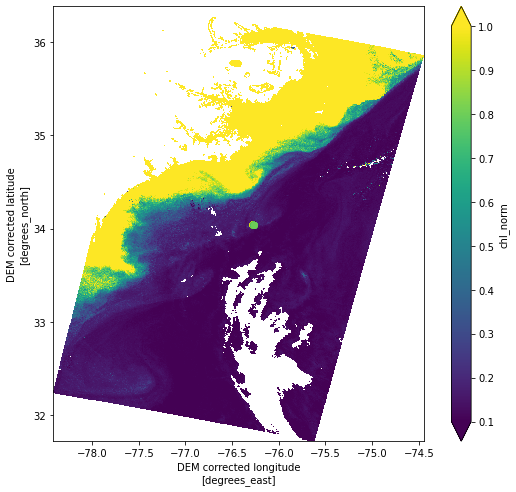

In [9]:
fig,ax = plt.subplots(figsize=(10,8))

olci_ds.chl_norm.plot(ax=ax,x='lon', y='lat', cmap='viridis',vmax=1, vmin=0.1)
gdf1.plot(column='chla',ax=ax, vmin=0.04,vmax=.12, cmap='viridis',alpha=0.6,)# norm=colors.LogNorm())
# Create a Rectangle patch
# rect = patches.Rectangle((-76.33, 34.13), .2, -.2, linewidth=1, edgecolor='black', facecolor='none')

# Add the patch to the Axes
# ax.add_patch(rect)

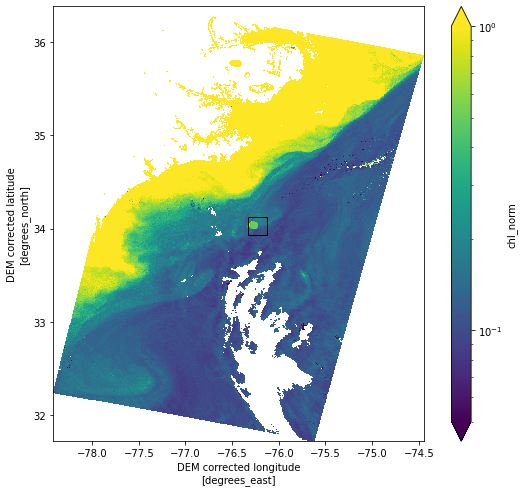

In [30]:
fig,ax = plt.subplots(figsize=(10,8))

olci_ds.chl_norm.plot(ax=ax,x='lon', y='lat', cmap='viridis',vmax=1, vmin=0.05,norm=colors.LogNorm())
gdf1.plot(column='chla',ax=ax, vmin=0.04,vmax=.12, cmap='viridis',alpha=0.6,)# norm=colors.LogNorm())
# Create a Rectangle patch
rect = patches.Rectangle((-76.33, 34.13), .2, -.2, linewidth=1, edgecolor='black', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)

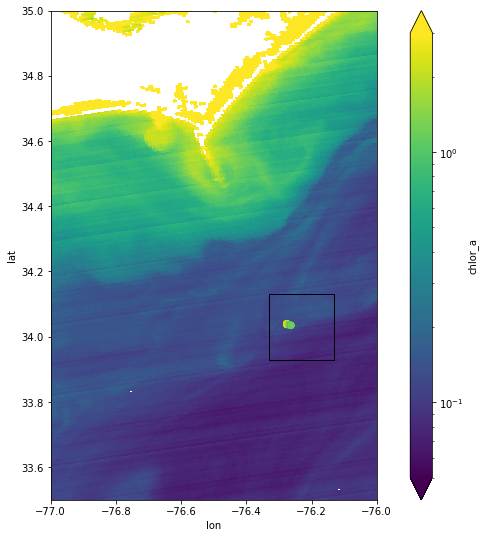

In [16]:
fig,ax = plt.subplots(figsize=(12,9))
viirs_ds.chlor_a.plot(x='lon', y='lat', vmax=3, vmin=0.05, cmap='viridis', norm=colors.LogNorm())
ax.set_xlim(-77,-76)
ax.set_ylim(33.5,35)
gdf1.plot(column='chla',ax=ax, vmin=0.04,vmax=.12, cmap='viridis',alpha=0.6,)# norm=colors.LogNorm())

# Create a Rectangle patch
rect = patches.Rectangle((-76.33, 34.13), .2, -.2, linewidth=1, edgecolor='black', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)

### Read in in-situ data

In [68]:
insitu_df = pd.read_csv('data/gulf_stream_survey_insitu_20210427.csv')
print(len(insitu_df))
insitu_df.head()

26


,Name,Flu,Chla,LatDeg,LatMin,LatMinDecimal,LonDeg,LonMin,LonMinDecimal,time,temp,flag,notes,type
0,Og1,2.24,0.1120,34,0,0.053,76,11,0.495,10:08:42,24.4,NaN,NaN,offshore
1,Og2,1.57,0.0785,34,0,0.359,76,11,0.540,10:11:53,24.4,NaN,NaN,offshore
2,Og3,1.27,0.0635,34,0,0.175,76,11,0.497,10:14:37,24.4,NaN,NaN,offshore
3,Og4,1.63,0.0815,34,0,0.463,76,11,0.598,10:17:00,24.4,NaN,NaN,offshore
4,Og5,1.53,0.0765,34,0,0.589,76,11,0.646,10:20:20,24.5,NaN,NaN,offshore


In [69]:
insitu_df = insitu_df[insitu_df['flag']!= 1]
print(len(insitu_df))

24


In [70]:
insitu_df['time'] = insitu_df.apply(lambda row: datetime.datetime.strptime('2021-04-27-' + row['time'], '%Y-%m-%d-%H:%M:%S'),axis=1)

In [71]:
insitu_df.head(1)

,Name,Flu,Chla,LatDeg,LatMin,LatMinDecimal,LonDeg,LonMin,LonMinDecimal,time,temp,flag,notes,type
0,Og1,2.24,0.112,34,0,0.053,76,11,0.495,2021-04-27 10:08:42,24.4,NaN,NaN,offshore


In [72]:
def dms2dd(degrees, minutes, seconds, direction):
    dd = float(degrees) + float(minutes)/60 + float(seconds)/(60*60);
    if direction == 'E' or direction == 'S':
        dd *= -1
    return(dd)

In [73]:
insitu_df['lon'] = insitu_df.apply(lambda row: dms2dd(row['LonDeg'], row['LonMin'] + row['LonMinDecimal'], 0, 'E'), axis=1)

In [74]:
insitu_df['lat'] = insitu_df.apply(lambda row: dms2dd(row['LatDeg'], row['LatMin'] + row['LatMinDecimal'], 0, 'N'), axis=1)

<AxesSubplot:xlabel='time', ylabel='Chla'>

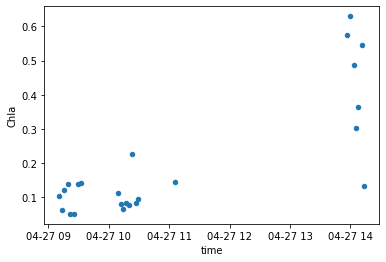

In [15]:
insitu_df.plot('time','Chla',kind='scatter')

In [75]:
insitu_gdf = gpd.GeoDataFrame(
    insitu_df, geometry=gpd.points_from_xy(insitu_df.lon, insitu_df.lat))

<AxesSubplot:>

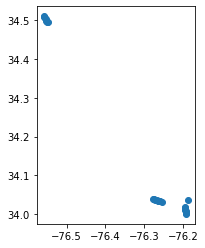

In [26]:
insitu_gdf.plot()

#### look up the closest point by location to the validation points 

In [17]:
# gdf_all_flights = pd.concat([gdf1,gdf2,gdf3,gdf4])
gdf_all_flights = pd.concat([gdf1,gdf2,gdf3])
gdf_all_flights

,chla,Latitude,Longitude,sst,time_str,geometry,sst_c,time,flight
0,0.122446,34.039461,-76.276736,289.23,2021-04-27 13:10:57,POINT (-76.27674 34.03946),16.08,2021-04-27 13:10:57,1
1,0.121662,34.039461,-76.276739,289.36,2021-04-27 13:10:59,POINT (-76.27674 34.03946),16.21,2021-04-27 13:10:59,1
2,0.121413,34.039461,-76.276739,289.47,2021-04-27 13:11:01,POINT (-76.27674 34.03946),16.32,2021-04-27 13:11:01,1
3,0.121824,34.039461,-76.276739,289.31,2021-04-27 13:11:03,POINT (-76.27674 34.03946),16.16,2021-04-27 13:11:03,1
4,0.120904,34.039461,-76.276733,289.74,2021-04-27 13:11:12,POINT (-76.27673 34.03946),16.59,2021-04-27 13:11:12,1
...,...,...,...,...,...,...,...,...,...
351,0.136566,34.054464,-76.212683,291.98,2021-04-27 15:57:37,POINT (-76.21268 34.05446),18.83,2021-04-27 15:57:37,3
352,0.137030,34.054511,-76.212689,291.05,2021-04-27 15:57:38,POINT (-76.21269 34.05451),17.90,2021-04-27 15:57:38,3
353,0.132488,34.054533,-76.212689,290.30,2021-04-27 15:57:41,POINT (-76.21269 34.05453),17.15,2021-04-27 15:57:41,3
354,0.133160,34.054528,-76.212689,290.06,2021-04-27 15:57:43,POINT (-76.21269 34.05453),16.91,2021-04-27 15:57:43,3


<AxesSubplot:>

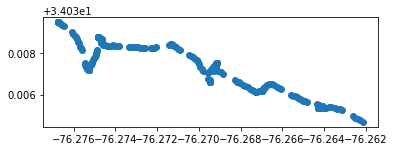

In [18]:
gdf1.plot()

<AxesSubplot:>

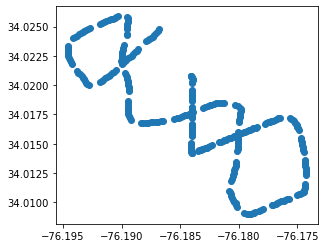

In [19]:
gdf2.plot()

<AxesSubplot:>

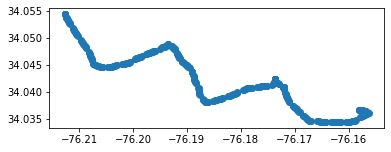

In [20]:
gdf3.plot()

<AxesSubplot:>

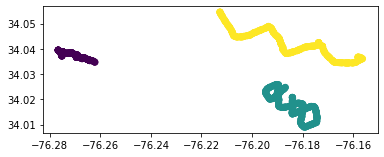

In [21]:
fig, ax = plt.subplots()
gdf_all_flights.plot(ax=ax,c=gdf_all_flights['flight'])

In [22]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = gdf_all_flights.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = gdf_all_flights.geometry == nearest_points(point, pts)[1]
    #print(gdf_all_flights[nearest].chla.values[0], gdf_all_flights[nearest].Latitude.values[0], gdf_all_flights[nearest].Longitude.values[0])
    return(gdf_all_flights[nearest].Latitude.values[0], gdf_all_flights[nearest].Longitude.values[0])

insitu_gdf['lat/lon'] = insitu_gdf.apply(lambda row: near(row.geometry), axis=1)
insitu_gdf.head(2)

,Name,Flu,Chla,LatDeg,LatMin,LatMinDecimal,LonDeg,LonMin,LonMinDecimal,time,temp,flag,notes,type,lon,lat,geometry,lat/lon
0,Og1,2.24,0.1120,34,0,0.053,76,11,0.495,2021-04-27 10:08:42,24.4,NaN,NaN,offshore,-76.191583,34.000883,POINT (-76.19158 34.00088),"(34.00963055555555, -76.18012222222222)"
1,Og2,1.57,0.0785,34,0,0.359,76,11,0.540,2021-04-27 10:11:53,24.4,NaN,NaN,offshore,-76.192333,34.005983,POINT (-76.19233 34.00598),"(34.016752777777775, -76.18836666666667)"


In [23]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = gdf_all_flights.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = gdf_all_flights.geometry == nearest_points(point, pts)[1]
    #print(gdf_all_flights[nearest].chla.values[0])
    return gdf_all_flights[nearest].chla.values[0]

insitu_gdf['uas_chla'] = insitu_gdf.apply(lambda row: near(row.geometry), axis=1)
insitu_gdf.head(2)

,Name,Flu,Chla,LatDeg,LatMin,LatMinDecimal,LonDeg,LonMin,LonMinDecimal,time,temp,flag,notes,type,lon,lat,geometry,lat/lon,uas_chla
0,Og1,2.24,0.1120,34,0,0.053,76,11,0.495,2021-04-27 10:08:42,24.4,NaN,NaN,offshore,-76.191583,34.000883,POINT (-76.19158 34.00088),"(34.00963055555555, -76.18012222222222)",0.053958
1,Og2,1.57,0.0785,34,0,0.359,76,11,0.540,2021-04-27 10:11:53,24.4,NaN,NaN,offshore,-76.192333,34.005983,POINT (-76.19233 34.00598),"(34.016752777777775, -76.18836666666667)",0.060768


In [24]:
insitu_gdf['uas_lat'] = insitu_gdf.apply(lambda row: row['lat/lon'][0], axis=1)
insitu_gdf['uas_lon'] = insitu_gdf.apply(lambda row: row['lat/lon'][1], axis=1)

In [25]:
insitu_gdf.head(1)

,Name,Flu,Chla,LatDeg,LatMin,LatMinDecimal,LonDeg,LonMin,LonMinDecimal,time,...,flag,notes,type,lon,lat,geometry,lat/lon,uas_chla,uas_lat,uas_lon
0,Og1,2.24,0.112,34,0,0.053,76,11,0.495,2021-04-27 10:08:42,...,NaN,NaN,offshore,-76.191583,34.000883,POINT (-76.19158 34.00088),"(34.00963055555555, -76.18012222222222)",0.053958,34.009631,-76.180122


In [36]:
pip install geopy

Note: you may need to restart the kernel to use updated packages.


In [26]:
import geopy.distance
def dist_fcn(sample_lat,sample_lon,uas_lat,uas_lon):
    coords_1 = (sample_lat, sample_lon)
    coords_2 = (uas_lat, uas_lon)
    return(geopy.distance.distance(coords_1, coords_2).km)

In [27]:
insitu_gdf['pt_dist'] = insitu_gdf.apply(lambda row: dist_fcn(row['lat'],row['lon'],row['uas_lat'],row['uas_lon']), axis=1)

In [28]:
insitu_gdf_front = insitu_gdf[insitu_gdf['type'] != 'inland']

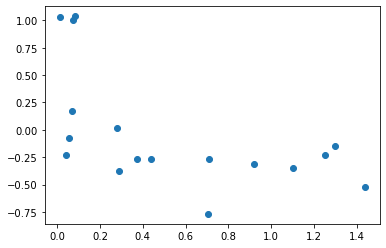

In [40]:
plt.scatter(insitu_gdf_front['pt_dist'], (insitu_gdf_front['uas_chla']-insitu_gdf_front['Chla'])/insitu_gdf_front['Chla'])

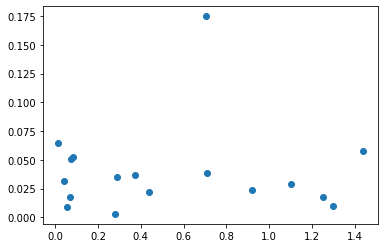

In [41]:
plt.scatter(insitu_gdf_front['pt_dist'], abs(insitu_gdf_front['uas_chla']-insitu_gdf_front['Chla']))

(0.0, 0.25)

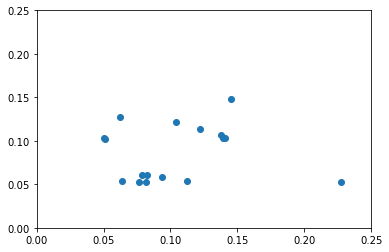

In [42]:
plt.scatter(insitu_gdf_front.Chla, insitu_gdf_front.uas_chla)
plt.xlim(0,.25)
plt.ylim(0,.25)

NameError: name 'sst_ds' is not defined

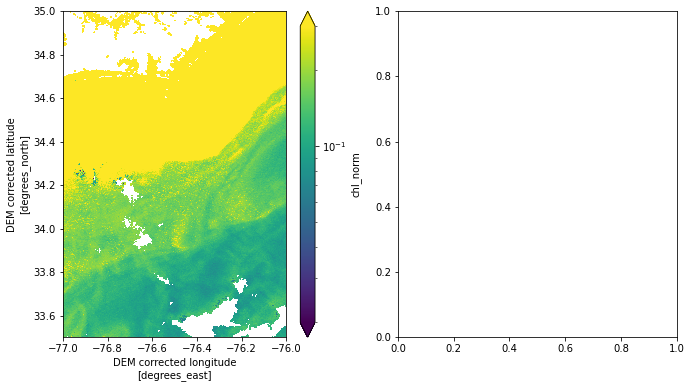

In [40]:
fig,ax = plt.subplots(1,2, figsize=(11,6))

olci_ds.chl_norm.plot(ax=ax[0],x='lon', y='lat', vmax=0.3, vmin=0.02, cmap='viridis', norm=colors.LogNorm())
ax[0].set_xlim(-77,-76)
ax[0].set_ylim(33.5,35)

sst_ds.sst.plot(ax=ax[1],x='lon', y='lat', vmax=17, vmin=28, cmap='inferno')
# sst_ds.sst.plot(ax=ax[1], x='lon', y='lat', vmax=17.5, vmin=26.5, cmap='inferno',)
ax[1].set_xlim(-77,-76)
ax[1].set_ylim(33.5,35)

# gdf1.plot(column='chla',ax=ax[0], vmin=0.04,vmax=1, cmap='viridis', norm=colors.LogNorm())
# gdf2.plot(column='chla',ax=ax[0], vmin=0.04,vmax=1, cmap='viridis', norm=colors.LogNorm())
# gdf3.plot(column='chla',ax=ax[0], vmin=0.04,vmax=1, cmap='viridis', norm=colors.LogNorm())

# gdf2.plot(column='chla',ax=ax[1], vmin=0.04,vmax=1, cmap='viridis', norm=colors.LogNorm())
fig.tight_layout()

import matplotlib.patches as patches


# Create a Rectangle patch
rect = patches.Rectangle((-76.33, 34.13), .2, -.2, linewidth=1, edgecolor='white', facecolor='none')

# Add the patch to the Axes
ax[0].add_patch(rect)
rect = patches.Rectangle((-76.33, 34.13), .2, -.2, linewidth=1, edgecolor='white', facecolor='none')
ax[1].add_patch(rect)
fig.show()
# plt.savefig('gs_overview.png',dpi=300)

(array([ 19.,  17.,  26.,  49., 113.,  67.,  53.,   1.,  10.,   1.]),
 array([0.07373741, 0.08557901, 0.09742062, 0.10926223, 0.12110383,
        0.13294544, 0.14478705, 0.15662865, 0.16847026, 0.18031187,
        0.19215347]),
 <BarContainer object of 10 artists>)

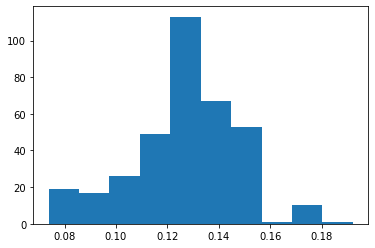

In [43]:
plt.hist(gdf3.chla)

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


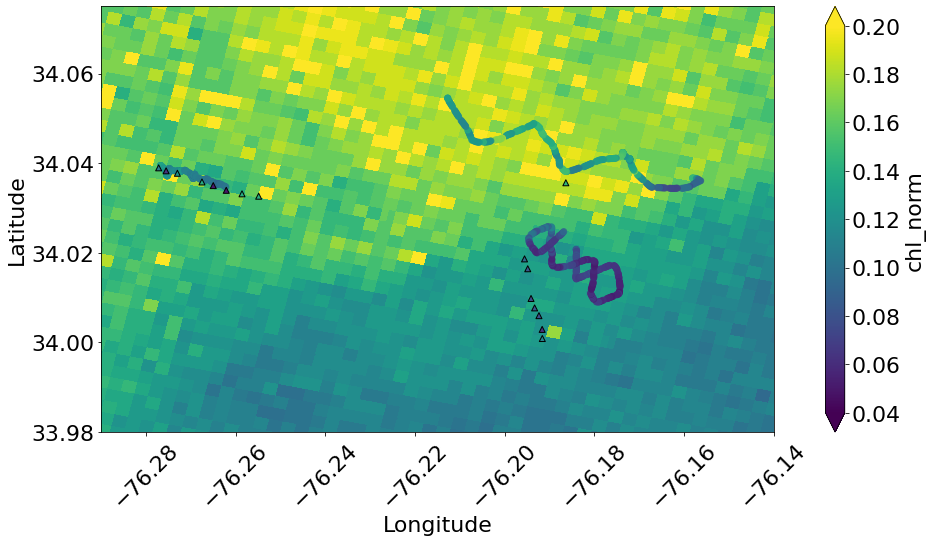

In [108]:
plt.rcParams.update({'font.size': 22})

fig,ax = plt.subplots(figsize=(16,8))
ax.tick_params(axis='x', rotation=45)

olci_ds.chl_norm.plot(ax=ax,x='lon', y='lat', vmax=.2, vmin=0.04, cmap='viridis')# norm=colors.LogNorm())
#sst_ds.sst.plot(ax=ax, x='lon', y='lat', vmax=17.5, vmin=26.5, cmap='inferno')
ax.set_xlim(-76.29,-76.14)
ax.set_ylim(33.98,34.075)

gdf1.plot(column='chla',ax=ax, vmin=0.04,vmax=.2, cmap='viridis',alpha=0.7,)# norm=colors.LogNorm())
gdf2.plot(column='chla',ax=ax, vmin=0.04,vmax=.2, cmap='viridis',alpha=0.7,)# norm=colors.LogNorm())
gdf3.plot(column='chla',ax=ax, vmin=0.04,vmax=.2, cmap='viridis',alpha=0.7,)# norm=colors.LogNorm())

insitu_gdf_front_cut.plot(column='Chla',ax=ax, vmin=0.04,vmax=.2, cmap='viridis',alpha=1,marker='^',edgecolor='black')

ax.set_ylabel('Latitude')
ax.set_xlabel('Longitude')

fig.tight_layout()
fig.show()
# plt.savefig('chla_map_uas_insitu_drone_flights_revision1.png',dpi=600)

### pull out values from OLCI based on drone locations

(33.98, 34.075)

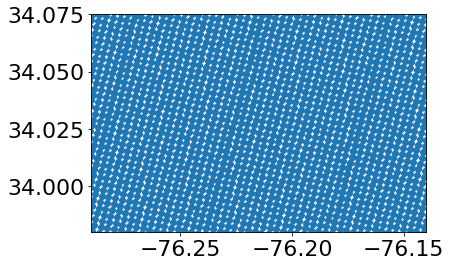

In [45]:
fig,ax = plt.subplots()
ax.scatter(olci_ds.lon, olci_ds.lat)
ax.set_xlim(-76.29,-76.14)
ax.set_ylim(33.98,34.075)

NameError: name 'centroids' is not defined

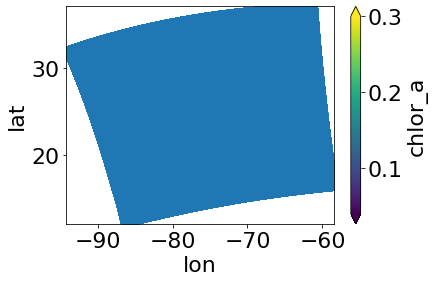

In [46]:
fig,ax = plt.subplots()
viirs_ds.chlor_a.plot(ax=ax,x='lon', y='lat', vmax=.3, vmin=0.04, cmap='viridis')
ax.scatter(viirs_ds.lon, viirs_ds.lat)

# I want to find the speed at a certain lat/lon point.
lat = centroids.y.iloc[0]
lon = centroids.x.iloc[0]

# First, find the index of the grid point nearest a specific lat/lon.   
abslat = np.abs(viirs_ds.lat-lat)
abslon = np.abs(viirs_ds.lon-lon)
c = np.maximum(abslon, abslat)

([xloc], [yloc]) = np.where(c == np.min(c))

# # Now I can use that index location to get the values at the x/y diminsion
point_ds = viirs_ds.isel(x=yloc, y=xloc)

# Plot requested lat/lon point blue
ax.scatter(lon, lat, color='b')
ax.text(lon, lat, 'requested')

# # Plot nearest point in the array red
ax.scatter(point_ds.lon, point_ds.lat, color='r')
ax.text(point_ds.lon, point_ds.lat, 'nearest')
ax.set_xlim(-76.29,-76.14)
ax.set_ylim(33.98,34.075)
plt.show()

#### Add in OLCI data

In [29]:
# this is based on https://stackoverflow.com/questions/58758480/xarray-select-nearest-lat-lon-with-multi-dimension-coordinates
values = []
centroids = gdf_all_flights.centroid
for i in range(len(centroids)):
    # I want to find the speed at a certain lat/lon point.
    lat = centroids.y.iloc[i]
    lon = centroids.x.iloc[i]

    # First, find the index of the grid point nearest a specific lat/lon.   
    abslat = np.abs(olci_ds.lat-lat)
    abslon = np.abs(olci_ds.lon-lon)
    c = np.maximum(abslon, abslat)
    if len(np.where(c == np.min(c))[0])==2:
        yloc = np.where(c == np.min(c))[0][0]
        xloc = np.where(c == np.min(c))[1][0]
    else:
        ([yloc], [xloc]) = np.where(c == np.min(c))
    # Now I can use that index location to get the values at the x/y diminsion
    point_ds = olci_ds.sel(columns=xloc, rows=yloc)

    values.append(point_ds.chl_norm.values)

In [30]:
gdf_all_flights['olci_chla'] = values

#### now add in MODIS data

In [31]:
# this is based on https://stackoverflow.com/questions/58758480/xarray-select-nearest-lat-lon-with-multi-dimension-coordinates
values = []
centroids = gdf_all_flights.centroid
for i in range(len(centroids)):
    # I want to find the speed at a certain lat/lon point.
    lat = centroids.y.iloc[i]
    lon = centroids.x.iloc[i]

    # First, find the index of the grid point nearest a specific lat/lon.   
    abslat = np.abs(modis_ds.lat-lat)
    abslon = np.abs(modis_ds.lon-lon)
    c = np.maximum(abslon, abslat)
    if len(np.where(c == np.min(c))[0])==2:
        xloc = np.where(c == np.min(c))[0][0]
        yloc = np.where(c == np.min(c))[1][0]
    else:
        ([xloc], [yloc]) = np.where(c == np.min(c))
    # Now I can use that index location to get the values at the x/y diminsion
    point_ds = modis_ds.sel(x=xloc, y=yloc)

    values.append(point_ds.chlor_a.values)

In [32]:
gdf_all_flights['modis_chla'] = values

#### finally VIIRS data

In [33]:
# this is based on https://stackoverflow.com/questions/58758480/xarray-select-nearest-lat-lon-with-multi-dimension-coordinates
values = []
centroids = gdf_all_flights.centroid
for i in range(len(centroids)):
    # I want to find the speed at a certain lat/lon point.
    lat = centroids.y.iloc[i]
    lon = centroids.x.iloc[i]

    # First, find the index of the grid point nearest a specific lat/lon.   
    abslat = np.abs(viirs_ds.lat-lat)
    abslon = np.abs(viirs_ds.lon-lon)
    c = np.maximum(abslon, abslat)
    if len(np.where(c == np.min(c))[0])==2:
        xloc = np.where(c == np.min(c))[0][0]
        yloc = np.where(c == np.min(c))[1][0]
    else:
        ([xloc], [yloc]) = np.where(c == np.min(c))
    # Now I can use that index location to get the values at the x/y diminsion
    point_ds = viirs_ds.isel(x=xloc, y=yloc)

    values.append(point_ds.chlor_a.values)

In [34]:
gdf_all_flights['viirs_chla'] = values

In [79]:
float(values[0])

0.11981068551540375

#### Save it out!

In [35]:
gdf_all_flights['olci_chla'] = [float(x) for x in gdf_all_flights['olci_chla']]

In [36]:
gdf_all_flights['modis_chla'] = [float(x) for x in gdf_all_flights['modis_chla']]

In [37]:
gdf_all_flights['viirs_chla'] = [float(x) for x in gdf_all_flights['viirs_chla']]

In [88]:
# gdf_all_flights.drop('time', 1).to_file('data/gdf_all_flights_sat_connected_270421.shp')

In [213]:
gdf_all_flights = gpd.read_file('data/gdf_all_flights_sat_connected_270421.shp')

Now compare these values with the uas_chla

In [192]:
gdf_all_flights.head(2)

,chla,Latitude,Longitude,sst,time_str,sst_c,flight,olci_chla,modis_chla,viirs_chla,geometry
0,0.122446,34.039461,-76.276736,289.23,2021-04-27 13:10:57,16.08,1,0.163154,0.166908,0.119811,POINT (-76.27674 34.03946)
1,0.121662,34.039461,-76.276739,289.36,2021-04-27 13:10:59,16.21,1,0.163154,0.166908,0.119811,POINT (-76.27674 34.03946)


In [56]:
# fig,ax = plt.subplots(figsize=(10,10))

# ax.scatter(gdf4.chla, values)
# # ax.set_ylim(0,.3)
# # ax.set_xlim(0,.3)

In [38]:
insitu_gdf_front_cut = insitu_gdf_front[insitu_gdf_front.Chla < 0.20]
insitu_gdf_front_cut = insitu_gdf_front_cut[insitu_gdf_front_cut.pt_dist < 3]

In [147]:
len(insitu_gdf_front_cut)

16

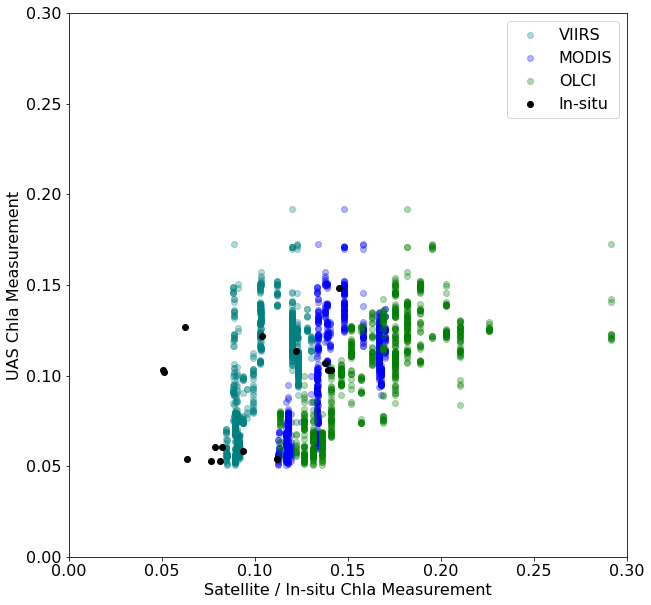

In [148]:
fig,ax = plt.subplots(figsize=(10,10))

ax.scatter(gdf_all_flights.viirs_chla, gdf_all_flights.chla, alpha=0.3, color='teal', label='VIIRS')
ax.scatter(gdf_all_flights.modis_chla, gdf_all_flights.chla, alpha=0.3, color='blue', label='MODIS')
ax.scatter(gdf_all_flights.olci_chla, gdf_all_flights.chla, alpha=0.3, color='green', label='OLCI')

ax.scatter(insitu_gdf_front_cut.Chla, insitu_gdf_front_cut.uas_chla,  color='black', label='In-situ')
ax.set_ylabel('UAS Chla Measurement')
ax.set_xlabel('Satellite / In-situ Chla Measurement')
ax.set_ylim(0,.3)
ax.set_xlim(0,.3)
ax.legend()
# ax.plot([0,1], [0,1], color='k', linestyle='--', linewidth=2, alpha=0.2)
# plt.savefig('sat_insitu_comparison.png', dpi=300)

In [87]:
plt.rcParams.update({'font.size': 15})

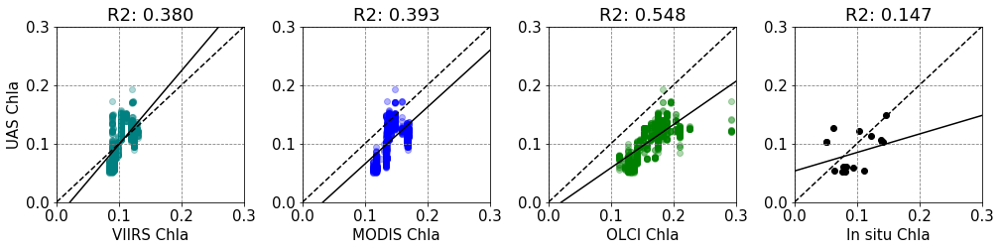

In [92]:
fig,ax = plt.subplots(1,4, figsize=(14,3.3))
plt.tight_layout()

ax[0].scatter(gdf_all_flights.viirs_chla, gdf_all_flights.chla, alpha=0.3, color='teal', label='VIIRS')
ax[1].scatter(gdf_all_flights.modis_chla, gdf_all_flights.chla, alpha=0.3, color='blue', label='MODIS')
ax[2].scatter(gdf_all_flights.olci_chla, gdf_all_flights.chla, alpha=0.3, color='green', label='OLCI')
ax[3].scatter(insitu_gdf_front_cut.Chla, insitu_gdf_front_cut.uas_chla,  color='black', label='In-situ')

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(gdf_all_flights.viirs_chla, gdf_all_flights.chla)
ax[0].plot([0,1],[0,1], color='black', ls='--')
ax[0].plot([0,1],[intercept,slope], color='black')
ax[0].set_title("R2: %.3f" % r_value**2)

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(gdf_all_flights.modis_chla, gdf_all_flights.chla)
ax[1].plot([0,1],[0,1], color='black', ls='--')
ax[1].plot([0,1],[intercept,slope], color='black')
ax[1].set_title("R2: %.3f" % r_value**2)

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(gdf_all_flights.olci_chla, gdf_all_flights.chla)
ax[2].plot([0,1],[0,1], color='black', ls='--')
ax[2].plot([0,1],[intercept,slope], color='black')
ax[2].set_title("R2: %.3f" % r_value**2)

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(insitu_gdf_front_cut.Chla, insitu_gdf_front_cut.uas_chla)
ax[3].plot([0,1],[0,1], color='black', ls='--')
ax[3].plot([0,1],[intercept,slope], color='black')
ax[3].set_title("R2: %.3f" % r_value**2)

ax[0].set_ylabel('UAS Chla')
ax[0].set_xlabel('VIIRS Chla')
# ax[1].set_ylabel('UAS Chla')
ax[1].set_xlabel('MODIS Chla')
# ax[2].set_ylabel('UAS Chla')
ax[2].set_xlabel('OLCI Chla')
# ax[3].set_ylabel('UAS Chla')
ax[3].set_xlabel('In situ Chla')

for i in range(4):
    ax[i].yaxis.grid(ls='--', c='grey')
    ax[i].xaxis.grid(ls='--', c='grey')
    
    ax[i].xaxis.set_tick_params(labelsize=15)
    ax[i].yaxis.set_tick_params(labelsize=15)

ax[0].set_ylim(0,.3)
ax[0].set_xlim(0,.3)
ax[1].set_ylim(0,.3)
ax[1].set_xlim(0,.3)
ax[2].set_ylim(0,.3)
ax[2].set_xlim(0,.3)
ax[3].set_ylim(0,.3)
ax[3].set_xlim(0,.3)
# ax[0].legend()
# ax[1].legend()
# ax[2].legend()
# ax.plot([0,1], [0,1], color='k', linestyle='--', linewidth=2, alpha=0.2)
plt.savefig('sat_insitu_comparison_revision1.png', dpi=600)

In [215]:
np.unique(gdf_all_flights.viirs_chla)

array([0.08472711, 0.08491374, 0.08841228, 0.08887053, 0.0894739 ,
       0.0899609 , 0.09071419, 0.09115477, 0.09168288, 0.09196111,
       0.09356927, 0.09395315, 0.09576917, 0.09892461, 0.10298427,
       0.10299817, 0.10328758, 0.11174584, 0.11981069, 0.12017878,
       0.122598  , 0.12312327, 0.12819454, 0.1302954 ])

In [216]:
len(gdf_all_flights.viirs_chla), len(np.unique(gdf_all_flights.viirs_chla))

(943, 24)

In [217]:
np.unique(gdf_all_flights.modis_chla)

array([0.11266027, 0.1131171 , 0.11700554, 0.11712532, 0.11808018,
       0.11946766, 0.12512977, 0.13021284, 0.1335302 , 0.13363491,
       0.13427162, 0.13776483, 0.13867868, 0.13963476, 0.14067258,
       0.14812677, 0.15837137, 0.16690752, 0.1679807 , 0.17032233])

In [218]:
len(gdf_all_flights.modis_chla), len(np.unique(gdf_all_flights.modis_chla))

(943, 20)

In [219]:
np.unique(gdf_all_flights.olci_chla)

array([0.11353195, 0.12207146, 0.12657915, 0.13125329, 0.13610002,
       0.14112578, 0.14633708, 0.1517408 , 0.15734409, 0.16315427,
       0.16917901, 0.17542621, 0.18190411, 0.18862122, 0.19558635,
       0.20280871, 0.21029773, 0.22611567, 0.29145193])

In [220]:
len(gdf_all_flights.olci_chla), len(np.unique(gdf_all_flights.olci_chla))

(943, 19)

In [221]:
len(gdf_all_flights.chla), len(np.unique(gdf_all_flights.chla))

(943, 943)

In [222]:
np.unique(insitu_gdf_front_cut.Chla)

array([0.0505, 0.051 , 0.0625, 0.0635, 0.0765, 0.0785, 0.0815, 0.0825,
       0.0935, 0.104 , 0.112 , 0.122 , 0.138 , 0.1395, 0.141 , 0.1455])

In [223]:
len(insitu_gdf_front_cut.Chla), len(np.unique(insitu_gdf_front_cut.Chla))

(16, 16)

In [224]:
slope, intercept

(0.3693267960191684, 0.05321120530849465)

In [40]:
import scipy.stats

In [226]:
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(gdf_all_flights.viirs_chla, gdf_all_flights.chla)
slope, intercept, r_value,r_value**2

(1.2304823125330957,
 -0.02692317234500323,
 0.6165165174313422,
 0.3800926162656704)

In [227]:
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(gdf_all_flights.modis_chla, gdf_all_flights.chla)
slope, intercept, r_value,r_value**2

(0.9385616582639896,
 -0.031632434580374805,
 0.6272874812187126,
 0.3934895840937167)

In [228]:
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(gdf_all_flights.olci_chla, gdf_all_flights.chla)
slope, intercept, r_value,r_value**2

(0.7233213867203175,
 -0.015199182556797475,
 0.7404826316526838,
 0.5483145277792842)

In [229]:
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(insitu_gdf_front_cut.Chla, insitu_gdf_front_cut.uas_chla)
slope, intercept, r_value,r_value**2

(0.3693267960191684,
 0.05321120530849465,
 0.38289765847327895,
 0.14661061686431975)

(0.0, 0.3)

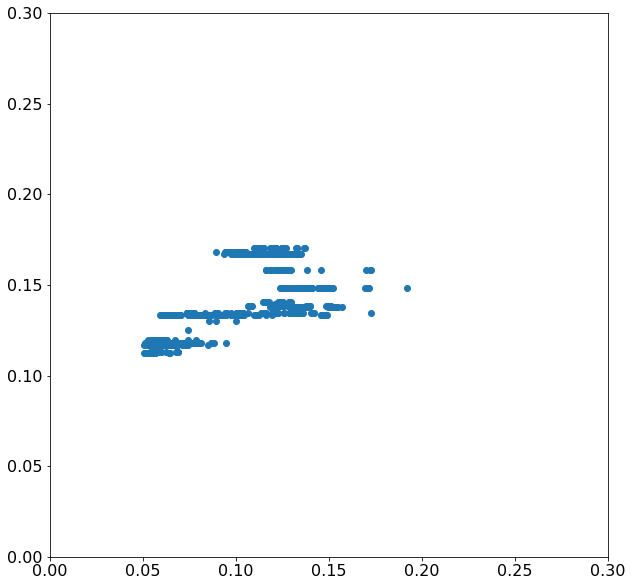

In [230]:
fig,ax = plt.subplots(figsize=(10,10))

ax.scatter(gdf_all_flights.chla, gdf_all_flights.modis_chla)
ax.set_ylim(0,.3)
ax.set_xlim(0,.3)

In [ ]:
fig,ax = plt.subplots(figsize=(10,10))

ax.scatter(gdf_all_flights.chla, gdf_all_flights.viirs_chla)
ax.set_ylim(0,.3)
ax.set_xlim(0,.3)

In [ ]:
len(values)

In [ ]:
plt.rcParams.update({'font.size': 22})

fig,ax = plt.subplots(figsize=(16,9))
ax.tick_params(axis='x', rotation=45)

#chl_ds.chlor_a.plot(ax=ax,x='lon', y='lat', vmax=.3, vmin=0.04, cmap='viridis', norm=colors.LogNorm())
sst_ds.sst.plot(ax=ax, x='lon', y='lat', vmax=17.5, vmin=26.5, cmap='inferno')
ax.set_xlim(-76.29,-76.14)
ax.set_ylim(33.98,34.075)

gdf1.plot(column='sst',ax=ax, vmin=289,vmax=294, cmap='inferno',alpha=0.6)
gdf2.plot(column='sst',ax=ax, vmin=289,vmax=294, cmap='inferno',alpha=0.6)
gdf3.plot(column='sst',ax=ax, vmin=289,vmax=294, cmap='inferno',alpha=0.6)

fig.show()
plt.savefig('chla_map_uas.png',dpi=300)

In [ ]:
fig,ax = plt.subplots(figsize=(12,12))

modis_ds.chlor_a.plot(ax=ax,x='lon', y='lat', vmax=.3, vmin=0.04, cmap='viridis', norm=colors.LogNorm())
ax.set_xlim(-76.22,-76.13)
ax.set_ylim(33.97,34.04)
gdf2.plot(column='chla',ax=ax, c=gdf2['chla'], vmin=0.04,vmax=.3, cmap='viridis', norm=colors.LogNorm())

In [3]:
sst_url = 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2021/0427/AQUA_MODIS.20210427.L3m.DAY.SST.sst.4km.NRT.nc'
sst_ds = xr.open_dataset(sst_url)
sst_ds

<xarray.Dataset>
Dimensions:   (eightbitcolor: 256, lat: 4320, lon: 8640, rgb: 3)
Coordinates:
  * lat       (lat) float32 89.98 89.94 89.9 89.85 ... -89.9 -89.94 -89.98
  * lon       (lon) float32 -180.0 -179.9 -179.9 -179.9 ... 179.9 179.9 180.0
Dimensions without coordinates: eightbitcolor, rgb
Data variables:
    palette   (rgb, eightbitcolor) int8 ...
    sst       (lat, lon) float32 ...
    qual_sst  (lat, lon) float32 ...
Attributes:
    product_name:                     AQUA_MODIS.20210427.L3m.DAY.SST.sst.4km...
    instrument:                       MODIS
    title:                            MODISA Level-3 Standard Mapped Image
    project:                          Ocean Biology Processing Group (NASA/GS...
    platform:                         Aqua
    temporal_range:                   day
    processing_version:               R2019.0
    date_created:                     2021-04-28T04:53:19.000Z
    history:                          l3mapgen par=AQUA_MODIS.20210427.L3m.DA...
    l2_flag_names:                    LAND,HISOLZEN
    time_coverage_start:              2021-04-27T00:20:01.000Z
    time_coverage_end:                2021-04-28T02:34:58.000Z
    start_orbit_number:               100999
    end_orbit_number:                 101014
    map_projection:                   Equidistant Cylindrical
    latitude_units:                   degrees_north
    longitude_units:                  degrees_east
    northernmost_latitude:            90.0
    southernmost_latitude:            -90.0
    westernmost_longitude:            -180.0
    easternmost_longitude:            180.0
    geospatial_lat_max:               90.0
    geospatial_lat_min:               -90.0
    geospatial_lon_max:               180.0
    geospatial_lon_min:               -180.0
    latitude_step:                    0.041666668
    longitude_step:                   0.041666668
    sw_point_latitude:                -89.979164
    sw_point_longitude:               -179.97917
    spatialResolution:                4.64 km
    geospatial_lon_resolution:        0.041666668
    geospatial_lat_resolution:        0.041666668
    geospatial_lat_units:             degrees_north
    geospatial_lon_units:             degrees_east
    number_of_lines:                  4320
    number_of_columns:                8640
    measure:                          Mean
    suggested_image_scaling_minimum:  -2.0
    suggested_image_scaling_maximum:  45.0
    suggested_image_scaling_type:     LINEAR
    suggested_image_scaling_applied:  No
    _lastModified:                    2021-04-28T04:53:19.000Z
    Conventions:                      CF-1.6 ACDD-1.3
    institution:                      NASA Goddard Space Flight Center, Ocean...
    standard_name_vocabulary:         CF Standard Name Table v36
    naming_authority:                 gov.nasa.gsfc.sci.oceandata
    id:                               AQUA_MODIS.20210427.L3b.DAY.SST.NRT.nc/...
    license:                          https://science.nasa.gov/earth-science/...
    creator_name:                     NASA/GSFC/OBPG
    publisher_name:                   NASA/GSFC/OBPG
    creator_email:                    data@oceancolor.gsfc.nasa.gov
    publisher_email:                  data@oceancolor.gsfc.nasa.gov
    creator_url:                      https://oceandata.sci.gsfc.nasa.gov
    publisher_url:                    https://oceandata.sci.gsfc.nasa.gov
    processing_level:                 L3 Mapped
    cdm_data_type:                    grid
    keywords:                         Earth Science > Oceans > Ocean Optics >...
    keywords_vocabulary:              NASA Global Change Master Directory (GC...
    _NCProperties:                    version=2,netcdf=4.7.3,hdf5=1.12.0,
    data_bins:                        Attribute edlided: Unsupported attribut...
    data_minimum:                     -1.8000001
    data_maximum:                     39.7725

In [4]:
ds.chl_ocx.attrs['long_name'] = "Chl-a"
ds.attrs['latitude_units'] = "" 
ds.attrs['longitude_units'] = ""
ds.attrs['geospatial_lat_units'] = "" 
ds.attrs['geospatial_lon_units'] = ""
ds

<xarray.Dataset>
Dimensions:  (eightbitcolor: 256, lat: 4320, lon: 8640, rgb: 3)
Coordinates:
  * lat      (lat) float32 89.98 89.94 89.9 89.85 ... -89.85 -89.9 -89.94 -89.98
  * lon      (lon) float32 -180.0 -179.9 -179.9 -179.9 ... 179.9 179.9 180.0
Dimensions without coordinates: eightbitcolor, rgb
Data variables:
    palette  (rgb, eightbitcolor) int8 -109 0 108 -112 0 111 ... 105 0 0 0 0 0
    chl_ocx  (lat, lon) float32 ...
Attributes:
    product_name:                      A2021117.L3m_DAY_CHL_chl_ocx_4km.nc
    instrument:                        MODIS
    title:                             MODISA Level-3 Standard Mapped Image
    project:                           Ocean Biology Processing Group (NASA/G...
    platform:                          Aqua
    temporal_range:                    day
    processing_version:                2018.1QL
    date_created:                      2021-05-13T23:38:29.000Z
    history:                           l3mapgen par=A2021117.L3m_DAY_CHL_chl_...
    l2_flag_names:                     ATMFAIL,LAND,HILT,HISATZEN,STRAYLIGHT,...
    time_coverage_start:               2021-04-27T00:20:01.000Z
    time_coverage_end:                 2021-04-28T02:59:59.000Z
    start_orbit_number:                100959
    end_orbit_number:                  100975
    map_projection:                    Equidistant Cylindrical
    latitude_units:                    
    longitude_units:                   
    northernmost_latitude:             90.0
    southernmost_latitude:             -90.0
    westernmost_longitude:             -180.0
    easternmost_longitude:             180.0
    geospatial_lat_max:                90.0
    geospatial_lat_min:                -90.0
    geospatial_lon_max:                180.0
    geospatial_lon_min:                -180.0
    latitude_step:                     0.041666668
    longitude_step:                    0.041666668
    sw_point_latitude:                 -89.979164
    sw_point_longitude:                -179.97917
    spatialResolution:                 4.64 km
    geospatial_lon_resolution:         0.041666668
    geospatial_lat_resolution:         0.041666668
    geospatial_lat_units:              
    geospatial_lon_units:              
    number_of_lines:                   4320
    number_of_columns:                 8640
    measure:                           Mean
    suggested_image_scaling_minimum:   0.01
    suggested_image_scaling_maximum:   20.0
    suggested_image_scaling_type:      LOG
    suggested_image_scaling_applied:   No
    _lastModified:                     2021-05-13T23:38:29.000Z
    Conventions:                       CF-1.6 ACDD-1.3
    institution:                       NASA Goddard Space Flight Center, Ocea...
    standard_name_vocabulary:          CF Standard Name Table v36
    naming_authority:                  gov.nasa.gsfc.sci.oceandata
    id:                                A2021117.L3b_DAY_CHL.nc/L3/A2021117.L3...
    license:                           https://science.nasa.gov/earth-science...
    creator_name:                      NASA/GSFC/OBPG
    publisher_name:                    NASA/GSFC/OBPG
    creator_email:                     data@oceancolor.gsfc.nasa.gov
    publisher_email:                   data@oceancolor.gsfc.nasa.gov
    creator_url:                       https://oceandata.sci.gsfc.nasa.gov
    publisher_url:                     https://oceandata.sci.gsfc.nasa.gov
    processing_level:                  L3 Mapped
    cdm_data_type:                     grid
    identifier_product_doi_authority:  http://dx.doi.org
    identifier_product_doi:            10.5067/AQUA/MODIS/L3M/CHL/2018
    keywords:                          Earth Science > Oceans > Ocean Chemist...
    keywords_vocabulary:               NASA Global Change Master Directory (G...
    _NCProperties:                     version=2,netcdf=4.7.3,hdf5=1.12.0,
    data_bins:                         Attribute edlided: Unsupported attribu...
    data_minimum:          

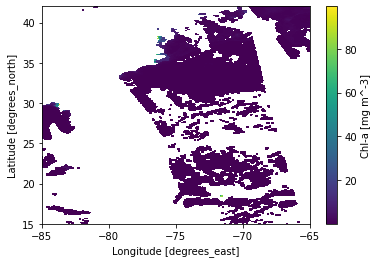

In [5]:
ds = ds.sel( lat=slice(42, 15), lon=slice(-85,-65))
ds.chl_ocx.plot()

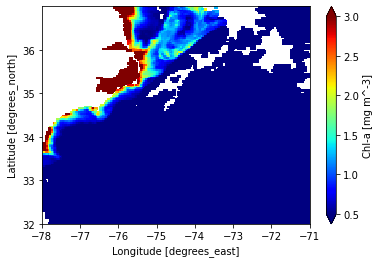

In [6]:
ds.sel( lat=slice(37, 32), lon=slice(-78,-71)).chl_ocx.plot(vmax=3, vmin=0.5, cmap='jet')

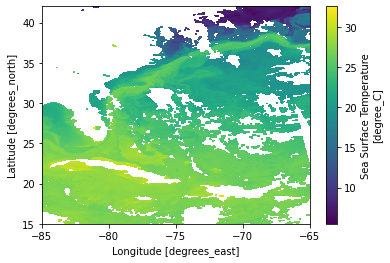

In [7]:
sst_ds = sst_ds.sel( lat=slice(42, 15), lon=slice(-85,-65))
sst_ds.sst.plot()

In [29]:
gdf2.hvplot(color=gdf2['chla'], cmap='viridis',size=100, alpha=0.7)

:Points   [x,y]   (_color)

In [31]:
df2.hvplot.points('Longitude', 'Latitude', color=df2['sst'], cmap='inferno',size=100, alpha=0.7)

:Points   [Longitude,Latitude]   (_color)

In [34]:
# chl_ds = chl_ds.sel( lat=slice(35, 33), lon=slice(-77,-75))
# sst_ds = sst_ds.sel( lat=slice(35, 33), lon=slice(-77,-75))

In [35]:
df2.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.04,.11))

:Points   [Longitude,Latitude]   (chla)

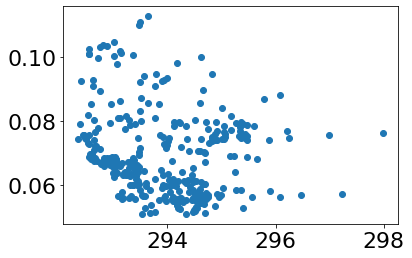

In [36]:
plt.scatter(df2['sst'], df2['chla'])

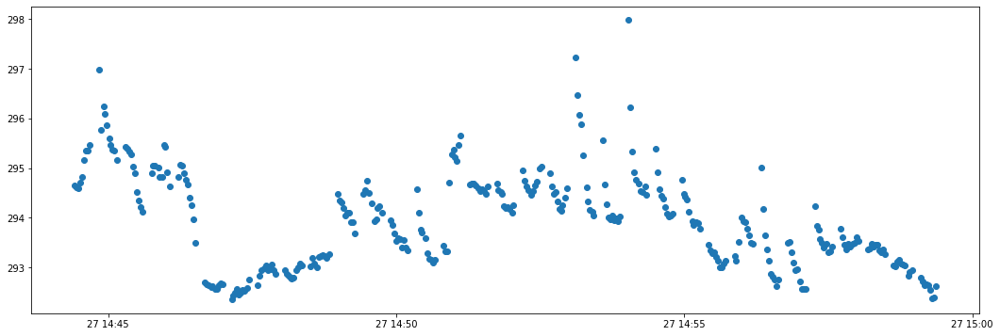

In [20]:
fig,ax = plt.subplots(figsize=(18,6))
ax.scatter(df2['time'], df2['sst'])

The osscilation in temp is clear in this plot...

In [21]:
df2.hvplot.points('time','sst')

:Points   [time,sst]

In [75]:
proj = crs.Orthographic(-90, 30)

modis_ds.chlor_a.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=False, coastline='10m', 
    frame_width=500, logz=True, clim=(0.01,1), rasterize=True)*\
df2.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.04,.11)) + \
sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=False, coastline='10m', 
    frame_width=500,rasterize=True)*\
df2.hvplot.points('Longitude', 'Latitude', color='sst', geo=True, cmap='inferno', clim=(292,295), alpha=0.8)

:Layout
   .Overlay.I  :Overlay
      .Image.I     :Image   [lon,lat]   (chlor_a)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (chla)
   .Overlay.II :Overlay
      .Image.I     :Image   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (sst)

In [50]:
proj = crs.Orthographic(-90, 30)

ds.chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=False, coastline='10m', 
    frame_width=500, logz=True, clim=(0.01,1), rasterize=True)*\
df2.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.04,.11)) + \
sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=False, coastline='10m', 
    frame_width=500,rasterize=True)*\
df2.hvplot.points('Longitude', 'Latitude', color='sst', geo=True, cmap='inferno', clim=(292,295), alpha=0.8)

/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/function_base.py:1280: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/srv/conda/envs/notebook/lib/python3.8/site-packages/holoviews/core/data/grid.py:276: RuntimeWarning: invalid value encountered in add
  return np.concatenate([first, coord[trim_last] + deltas, last], axis=axis)
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/function_base.py:1280: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/srv/conda/envs/notebook/lib/python3.8/site-packages/holoviews/core/data/grid.py:276: RuntimeWarning: invalid value encountered in add
  return np.concatenate([first, coord[trim_last] + deltas, last], axis=axis)
/srv/conda/envs/notebook/lib/python3.8/site-packages/numpy/lib/function_base.py:1280: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/srv/conda/envs/notebook/lib/python3.8/site-packages/datashader

:Layout
   .Overlay.I  :Overlay
      .Image.I     :Image   [lon,lat]   (chl_ocx)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (chla)
   .Overlay.II :Overlay
      .Image.I     :Image   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (sst)

<AxesSubplot:xlabel='lon', ylabel='lat'>

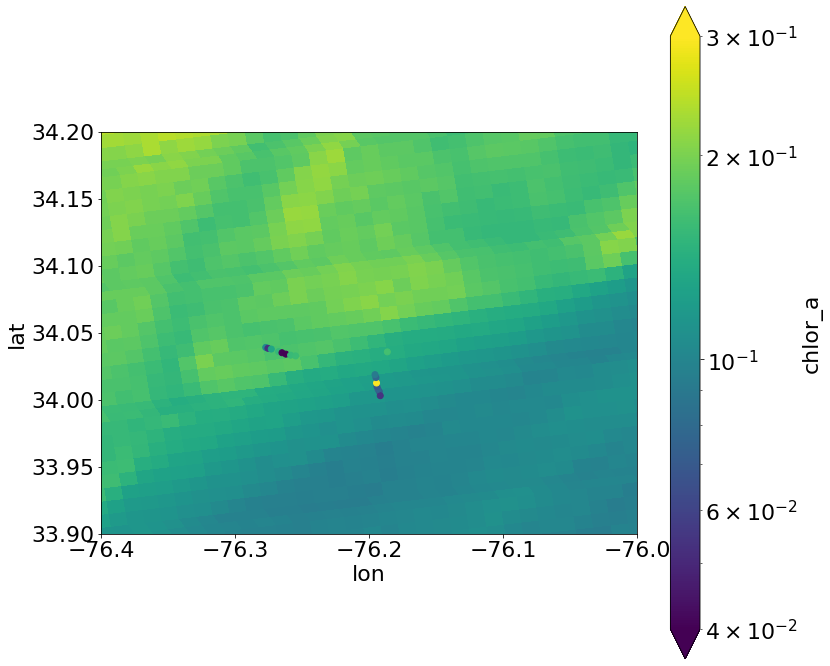

In [239]:
fig,ax = plt.subplots(figsize=(12,12))

modis_ds.chlor_a.plot(ax=ax,x='lon', y='lat', vmax=.3, vmin=0.04, cmap='viridis', norm=colors.LogNorm())
ax.set_xlim(-76.4,-76)
ax.set_ylim(33.9,34.2)
# gdf2.plot(column='chla',ax=ax, vmin=0.04,vmax=.3, cmap='viridis', norm=colors.LogNorm())
# gdf1.plot(column='chla',ax=ax, vmin=0.04,vmax=.3, cmap='viridis', norm=colors.LogNorm())
# gdf3.plot(column='chla',ax=ax, vmin=0.04,vmax=.3, cmap='viridis', norm=colors.LogNorm())
insitu_gdf_front.plot(column='Chla', ax=ax, vmin=0.04,vmax=.3, cmap='viridis', norm=colors.LogNorm())

<AxesSubplot:>

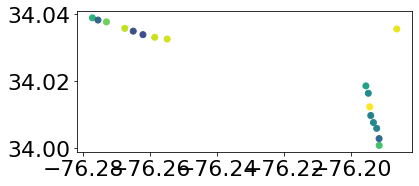

In [240]:
insitu_gdf_front.plot(column='Chla', vmin=0.02,vmax=.15, cmap='viridis')

TypeError: multiple values for argument 'x'

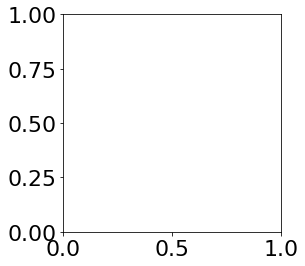

In [184]:
insitu_gdf_front.plot(x='Chla', y='uas_chla', vmin=0.02,vmax=.15, cmap='viridis')

In [182]:
insitu_df = insitu_gdf_front.drop('geometry', axis=1)

In [183]:
insitu_df.hvplot.points('lon', 'lat', color='Chla', geo=True, cmap='viridis', clim=(0.02,.15), alpha=0.8)

:Points   [lon,lat]   (Chla)

<AxesSubplot:xlabel='lon', ylabel='lat'>

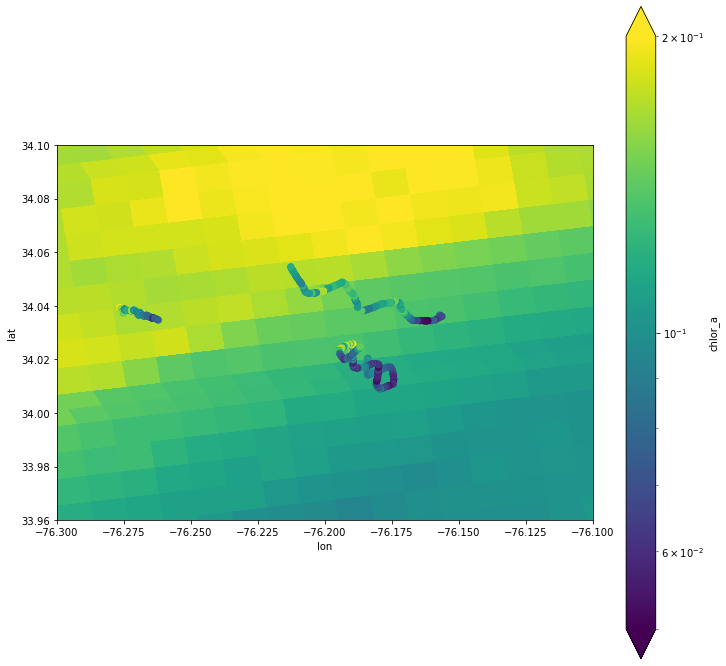

In [43]:
fig,ax = plt.subplots(figsize=(12,12))

chl_ds.chlor_a.plot(ax=ax,x='lon', y='lat', vmax=.2, vmin=0.05, cmap='viridis', norm=colors.LogNorm())
ax.set_xlim(-76.30,-76.1)
ax.set_ylim(33.96,34.1)
gdf2.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis', norm=colors.LogNorm())
gdf1.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis', norm=colors.LogNorm())
gdf3.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis', norm=colors.LogNorm())

In [74]:
gdf3['chla_rolling'] = gdf3.chla.rolling(10).mean()

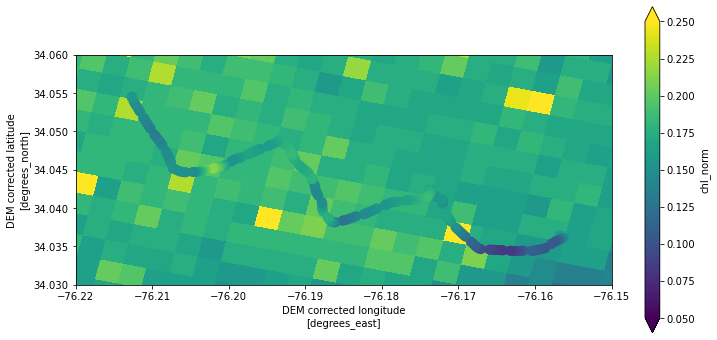

In [76]:
fig,ax = plt.subplots(figsize=(12,6))

olci_ds.chl_norm.plot(ax=ax,x='lon', y='lat', vmax=.25, vmin=0.05, cmap='viridis')#, norm=colors.LogNorm())
ax.set_xlim(-76.22,-76.15)
ax.set_ylim(34.03,34.06)
# gdf2.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis', norm=colors.LogNorm())
# gdf1.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis', norm=colors.LogNorm())
gdf3.plot(column='chla_rolling',ax=ax, vmin=0.05,vmax=.2, cmap='viridis',s=80)#, norm=colors.LogNorm())
plt.savefig('flight_3_zoom_zoom.png',dpi=300)

In [78]:
gdf2['chla_rolling'] = gdf2.chla.rolling(10).mean()

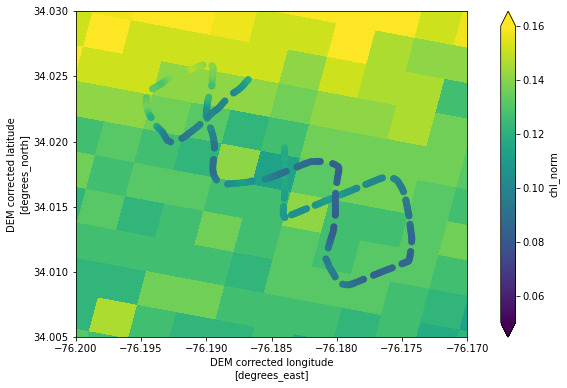

In [84]:
fig,ax = plt.subplots(figsize=(12,6))

olci_ds.chl_norm.plot(ax=ax,x='lon', y='lat', vmax=.16, vmin=0.05, cmap='viridis')#, norm=colors.LogNorm())
ax.set_xlim(-76.20,-76.17)
ax.set_ylim(34.005,34.03)
gdf2.plot(column='chla_rolling',ax=ax, vmin=0.03,vmax=.11, cmap='viridis')#, norm=colors.LogNorm())
# gdf1.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis', norm=colors.LogNorm())
# gdf3.plot(column='chla',ax=ax, vmin=0.05,vmax=.2, cmap='viridis',s=80)#, norm=colors.LogNorm())
plt.savefig('flight_2_zoom_zoom.png',dpi=300)

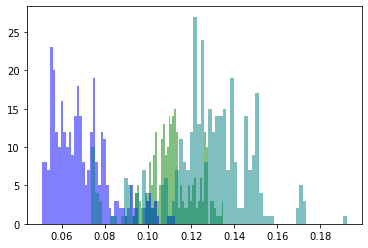

In [44]:
plt.hist(gdf1['chla'], color='green', alpha=0.5, bins=50)
plt.hist(gdf2['chla'], color='blue', alpha=0.5, bins=50)
plt.hist(gdf3['chla'], color='teal', alpha=0.5, bins=70)

plt.show()
# gdf3.hist(column='chla',vmin=0.05)
# gdf2.hist(column='chla')

<AxesSubplot:>

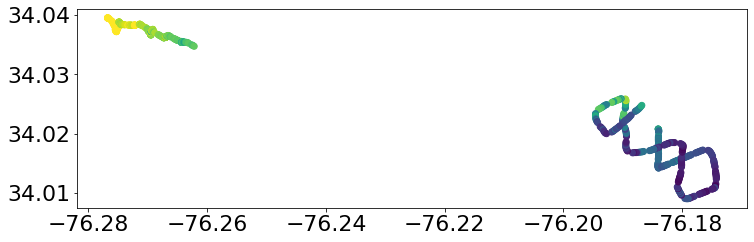

In [49]:
fig,ax = plt.subplots(figsize=(12,12))
gdf2.plot(column='chla',ax=ax, vmin=0.05,vmax=.12, cmap='viridis')
gdf1.plot(column='chla',ax=ax, vmin=0.05,vmax=.12, cmap='viridis')

In [22]:
df1.hvplot.points('Longitude', 'Latitude', color='sst_c', cmap='inferno',size=50, alpha=0.7) + \
df1.hvplot.points('Longitude', 'Latitude', color='chla', cmap='viridis', size=50, alpha=0.8, clim=(0.09,.13))

:Layout
   .Points.I  :Points   [Longitude,Latitude]   (sst_c)
   .Points.II :Points   [Longitude,Latitude]   (chla)

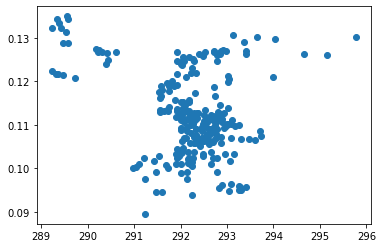

In [23]:
plt.scatter(df1['sst'], df1['chla'])

In [24]:
df1.hvplot.points('time','sst')

:Points   [time,sst]

In [25]:
ds.chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='viridis', dynamic=False, coastline='110m', 
    frame_width=500, logz=False, clim=(0.09,.20), rasterize=False)*\
df1.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(0.09,.20)) + \
sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=False, coastline='110m', 
    frame_width=500,rasterize=False, clim=(19,25))*\
df1.hvplot.points('Longitude', 'Latitude', color='sst_c', geo=True, cmap='inferno', clim=(19-5,25-5), alpha=0.8)

:Layout
   .Overlay.I  :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chl_ocx)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (chla)
   .Overlay.II :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Points.I    :Points   [Longitude,Latitude]   (sst_c)

In [26]:
ds.sel( lat=slice(37, 32), lon=slice(-78,-71)).chl_ocx.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline='10m', 
    frame_width=500, logz=True, clim=(0.01,2), rasterize=True) + \
sst_ds.sel( lat=slice(37, 32), lon=slice(-78,-71)).sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=True, coastline='10m', 
    frame_width=500,rasterize=True)

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .Image.I     :Image   [lon,lat]   (chl_ocx)
         .Coastline.I :Feature   [Longitude,Latitude]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .Image.I     :Image   [lon,lat]   (sst)
         .Coastline.I :Feature   [Longitude,Latitude]

In [29]:
df4.hvplot.points('Longitude', 'Latitude', color='sst_c', cmap='inferno',size=50, alpha=0.7) + \
df4.hvplot.points('Longitude', 'Latitude', color='chla', cmap='viridis', size=50, alpha=0.8, clim=(1.8,2.2))

:Layout
   .Points.I  :Points   [Longitude,Latitude]   (sst_c)
   .Points.II :Points   [Longitude,Latitude]   (chla)

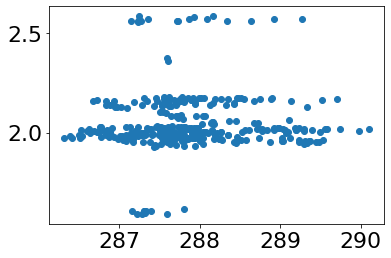

In [115]:
plt.scatter(df4['sst'], df4['chla'])

In [31]:
df4.hvplot.points('time','sst')

:Points   [time,sst]

In [32]:
df4.hvplot.points('time','chla')

:Points   [time,chla]

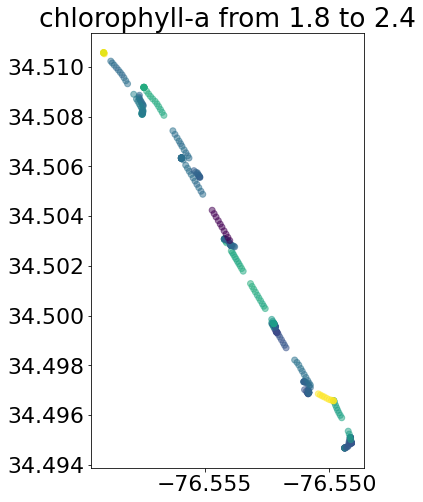

In [262]:
fig,ax=plt.subplots(figsize=(10,8))
ax.set_title('chlorophyll-a from 1.8 to 2.4')
gdf4.plot(ax=ax,column='chla', vmin=1.8, vmax=2.4, alpha=.5)
plt.savefig('chla_spatially.png')

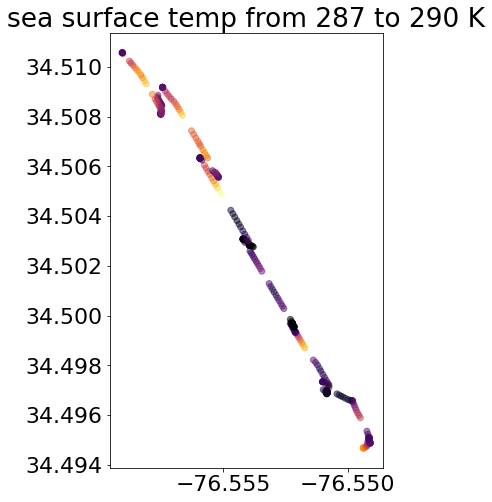

In [263]:
fig,ax=plt.subplots(figsize=(10,8))
ax.set_title('sea surface temp from 287 to 290 K')
gdf4.plot(ax=ax,column='sst',cmap='inferno', vmin=287, vmax=290, alpha=.5)
plt.savefig('sst_spatially.png')

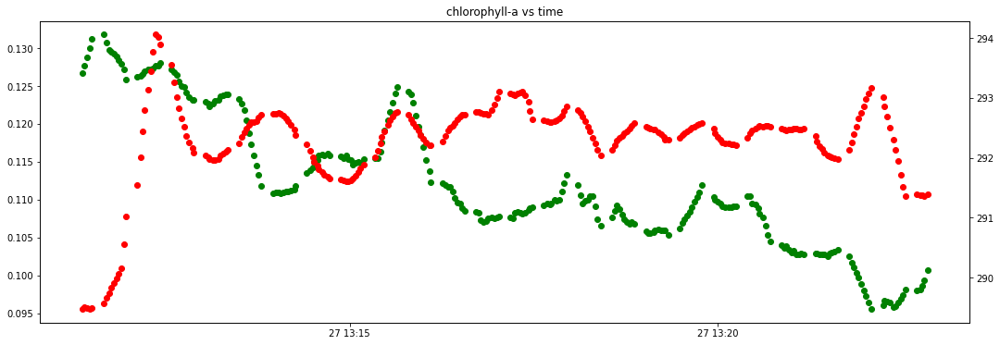

In [46]:
fig,ax = plt.subplots(figsize=(18,6))
ax.set_title('chlorophyll-a vs time')
ax.scatter(df1['time'], df1['chla'].rolling(10).mean(), color='green')
ax2 = ax.twinx()
ax2.scatter(df1['time'], df1['sst'].rolling(10).mean(), color='red')
# plt.savefig('chla_over_time.png')

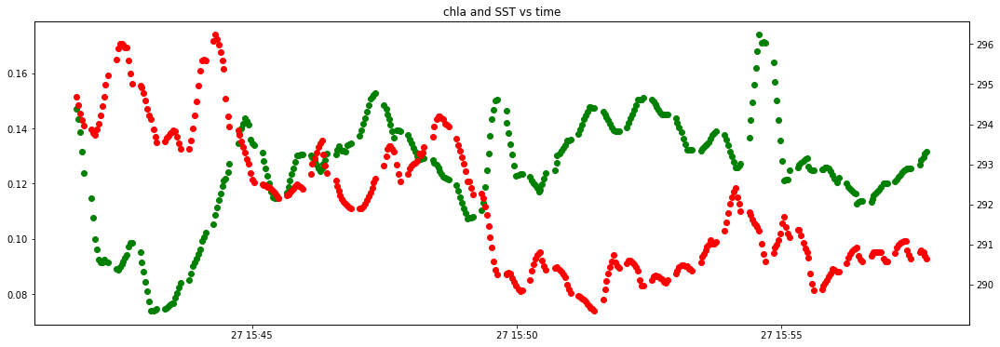

In [70]:
fig,ax = plt.subplots(figsize=(18,6))
ax.set_title('chla and SST vs time')
ax.scatter(df3['time'], df3['chla'].rolling(7).mean(), color='green')
ax2 = ax.twinx()
ax2.scatter(df3['time'], df3['sst'].rolling(7).mean(), color='red')
plt.savefig('chla+sst_over_time_flight3.png')

<AxesSubplot:>

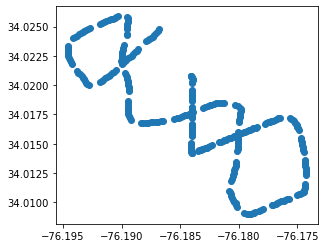

In [41]:
gdf2.plot()

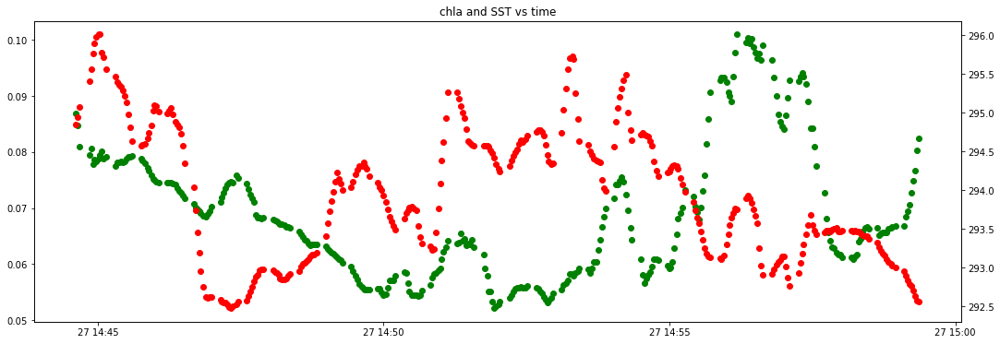

In [71]:
fig,ax = plt.subplots(figsize=(18,6))
ax.set_title('chla and SST vs time')
ax.scatter(df2['time'], df2['chla'].rolling(7).mean(), color='green')
ax2 = ax.twinx()
ax2.scatter(df2['time'], df2['sst'].rolling(7).mean(), color='red')
plt.savefig('chla+sst_over_time_flight2.png')

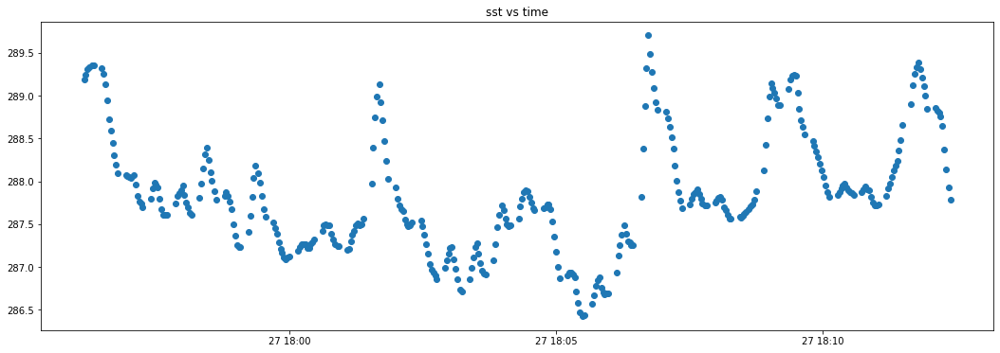

In [26]:
fig,ax = plt.subplots(figsize=(18,6))
ax.set_title('sst vs time')
ax.scatter(df4['time'], df4['sst'].rolling(5).mean())
# plt.savefig('sst_over_time.png')

In [ ]:
proj = crs.Orthographic(-90, 30)

chl_ds.chlor_a.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='viridis', dynamic=False, coastline='10m', 
    frame_width=500, logz=False, clim=(1,3), rasterize=False)*\
df4.hvplot.points('Longitude', 'Latitude', color='chla', geo=True,  cmap='viridis', alpha=0.8, clim=(1.7,2.3)) + \
sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=False, coastline='10m', 
    frame_width=500,rasterize=False, clim=(18,20))*\
df4.hvplot.points('Longitude', 'Latitude', color='sst_c', geo=True, cmap='inferno', clim=(18-5,20-5), alpha=0.8)